In [1]:
#quick random forest regression for predicting wins
import pandas as pd
import numpy as np
import seaborn as sn
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import mean_absolute_error

In [2]:
player_attributes = pd.read_csv('player_attributes_CLEANED.csv')
player_attributes

,player_id,date,overall_rating,potential,preferred_foot,attacking_work_rate,defensive_work_rate,crossing,finishing,heading_accuracy,...,vision,penalties,marking,standing_tackle,sliding_tackle,gk_diving,gk_handling,gk_kicking,gk_positioning,gk_reflexes
0,505942,2016-02-18,67.0,71.0,right,medium,medium,49.0,44.0,71.0,...,54.0,48.0,65.0,69.0,69.0,6.0,11.0,10.0,8.0,8.0
1,505942,2015-11-19,67.0,71.0,right,medium,medium,49.0,44.0,71.0,...,54.0,48.0,65.0,69.0,69.0,6.0,11.0,10.0,8.0,8.0
2,505942,2015-09-21,62.0,66.0,right,medium,medium,49.0,44.0,71.0,...,54.0,48.0,65.0,66.0,69.0,6.0,11.0,10.0,8.0,8.0
3,505942,2015-03-20,61.0,65.0,right,medium,medium,48.0,43.0,70.0,...,53.0,47.0,62.0,63.0,66.0,5.0,10.0,9.0,7.0,7.0
4,505942,2007-02-22,61.0,65.0,right,medium,medium,48.0,43.0,70.0,...,53.0,47.0,62.0,63.0,66.0,5.0,10.0,9.0,7.0,7.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
183137,39902,2009-08-30,83.0,85.0,right,medium,low,84.0,77.0,59.0,...,88.0,83.0,22.0,31.0,30.0,9.0,20.0,84.0,20.0,20.0
183138,39902,2009-02-22,78.0,80.0,right,medium,low,74.0,76.0,53.0,...,88.0,70.0,32.0,31.0,30.0,9.0,20.0,73.0,20.0,20.0
183139,39902,2008-08-30,77.0,80.0,right,medium,low,74.0,71.0,53.0,...,88.0,70.0,32.0,31.0,30.0,9.0,20.0,73.0,20.0,20.0
183140,39902,2007-08-30,78.0,81.0,right,medium,low,74.0,64.0,57.0,...,88.0,53.0,28.0,32.0,30.0,9.0,20.0,73.0,20.0,20.0


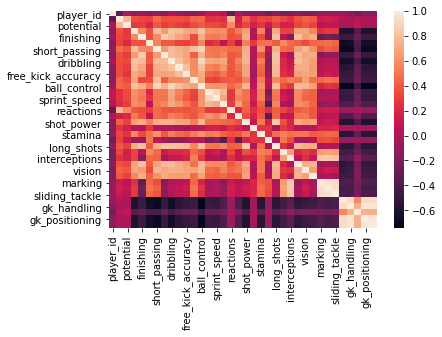

In [3]:
corrMatrix = player_attributes.corr()
sn.heatmap(corrMatrix, annot=False)
plt.show()

In [26]:
X, y = player_attributes.drop(columns=['player_id', 'date', 'overall_rating', 'potential']), player_attributes['overall_rating']

categorical_cols = ['preferred_foot', 'attacking_work_rate', 'defensive_work_rate']

for col in categorical_cols:
    new_cols = pd.get_dummies(X[col], prefix=col)
    X = pd.concat([X, new_cols], axis=1)

X = X.drop(columns=categorical_cols)

X.head()

,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,free_kick_accuracy,long_passing,ball_control,...,defensive_work_rate_9,defensive_work_rate__0,defensive_work_rate_ean,defensive_work_rate_es,defensive_work_rate_high,defensive_work_rate_low,defensive_work_rate_medium,defensive_work_rate_o,defensive_work_rate_ormal,defensive_work_rate_tocky
0,49.0,44.0,71.0,61.0,44.0,51.0,45.0,39.0,64.0,49.0,...,0,0,0,0,0,0,1,0,0,0
1,49.0,44.0,71.0,61.0,44.0,51.0,45.0,39.0,64.0,49.0,...,0,0,0,0,0,0,1,0,0,0
2,49.0,44.0,71.0,61.0,44.0,51.0,45.0,39.0,64.0,49.0,...,0,0,0,0,0,0,1,0,0,0
3,48.0,43.0,70.0,60.0,43.0,50.0,44.0,38.0,63.0,48.0,...,0,0,0,0,0,0,1,0,0,0
4,48.0,43.0,70.0,60.0,43.0,50.0,44.0,38.0,63.0,48.0,...,0,0,0,0,0,0,1,0,0,0


In [30]:
regr = RandomForestRegressor()
regr.fit(X, y)

RandomForestRegressor()

<BarContainer object of 10 artists>

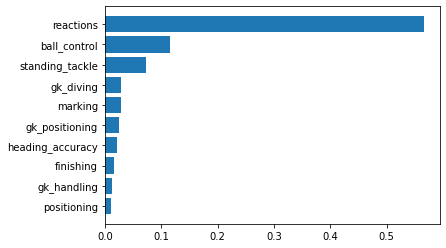

In [49]:
importances = regr.feature_importances_
sorted_idx = regr.feature_importances_.argsort()[-10:]
plt.barh(X.columns[sorted_idx], regr.feature_importances_[sorted_idx])

In [3]:
players = pd.read_csv('player.csv')
players = players[["player_id", "birthday"]]
player_attributes_age = player_attributes[["player_id","date","overall_rating"]]
player_attributes_age = player_attributes_age.join(players.set_index('player_id'), on="player_id", how="inner")
player_attributes_age["birthday"] = pd.to_datetime(player_attributes_age["birthday"])
player_attributes_age["date"] = pd.to_datetime(player_attributes_age["date"])
player_attributes_age["age"] = (player_attributes_age["date"] - player_attributes_age["birthday"]).dt.days / 365

player_attributes_age["age"] = player_attributes_age["age"].apply(lambda x: x if x > 0 else 100+x)


player_id
2625      AxesSubplot(0.125,0.125;0.775x0.755)
2752      AxesSubplot(0.125,0.125;0.775x0.755)
2768      AxesSubplot(0.125,0.125;0.775x0.755)
2770      AxesSubplot(0.125,0.125;0.775x0.755)
2790      AxesSubplot(0.125,0.125;0.775x0.755)
                          ...                 
744907    AxesSubplot(0.125,0.125;0.775x0.755)
746419    AxesSubplot(0.125,0.125;0.775x0.755)
748432    AxesSubplot(0.125,0.125;0.775x0.755)
750435    AxesSubplot(0.125,0.125;0.775x0.755)
750584    AxesSubplot(0.125,0.125;0.775x0.755)
Length: 11060, dtype: object

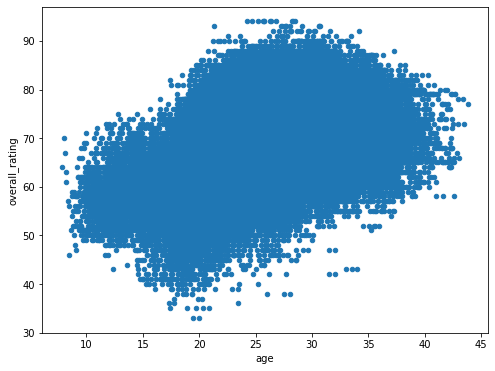

In [108]:
fig, ax = plt.subplots(figsize=(8,6))
player_attributes_age = player_attributes_age[["player_id", "age", "overall_rating"]]
player_attributes_age.groupby('player_id').plot.scatter(x="age", y="overall_rating", ax=ax)

In [4]:
player_attributes_age.head()

,player_id,date,overall_rating,birthday,age
0,505942,2016-02-18,67.0,1992-02-29,23.986301
1,505942,2015-11-19,67.0,1992-02-29,23.736986
2,505942,2015-09-21,62.0,1992-02-29,23.575342
3,505942,2015-03-20,61.0,1992-02-29,23.068493
4,505942,2007-02-22,61.0,1992-02-29,14.991781


In [5]:
player_attributes_age = player_attributes_age[['player_id', 'overall_rating', 'age']]
player_attributes_age['age'] = player_attributes_age['age'].apply(np.int64)
player_attributes_age = player_attributes_age.groupby('player_id').agg({'overall_rating':'max', 'age':'min'})[['overall_rating','age']]
player_attributes_age


,overall_rating,age
player_id,,
2625,63.0,26
2752,72.0,24
2768,75.0,24
2770,74.0,24
2790,73.0,33
...,...,...
744907,53.0,9
746419,59.0,9
748432,58.0,10


In [6]:
player_attributes_age = player_attributes_age[player_attributes_age['age']>=20]
player_attributes_age['overall_rating'] = pd.qcut(player_attributes_age['overall_rating'], 10)
player_attributes_age['age'] = pd.qcut(player_attributes_age['age'], 5)
player_attributes_age

ipykernel_launcher:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
ipykernel_launcher:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


,overall_rating,age
player_id,,
2625,"(45.999, 64.0]","(25.0, 27.0]"
2752,"(71.0, 73.0]","(23.0, 25.0]"
2768,"(74.0, 76.0]","(23.0, 25.0]"
2770,"(73.0, 74.0]","(23.0, 25.0]"
2790,"(71.0, 73.0]","(27.0, 40.0]"
...,...,...
429847,"(45.999, 64.0]","(19.999, 21.0]"
449484,"(74.0, 76.0]","(19.999, 21.0]"
500575,"(67.0, 69.0]","(21.0, 23.0]"


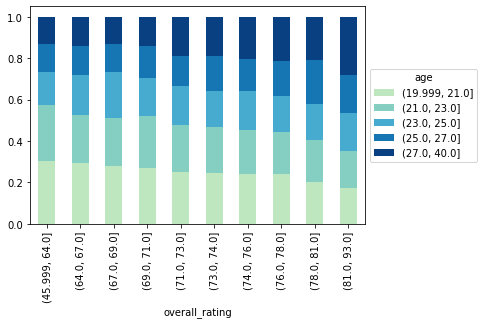

In [7]:
result = player_attributes_age.groupby(['overall_rating']).age.value_counts().unstack().T
result = result.div(result.sum())
result.T.plot.bar(stacked=True, color=plt.cm.GnBu(np.linspace(0.3, 1, 5))).legend(loc='center left',bbox_to_anchor=(1.0, 0.5), title='age')